## **1. Image thresholding**


### Lab Task 01 :
Write a function to perform image thresholding using point
processing taking the image file and the threshold value from the user.

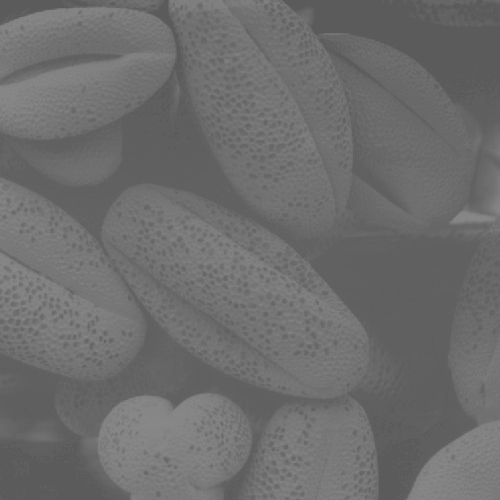

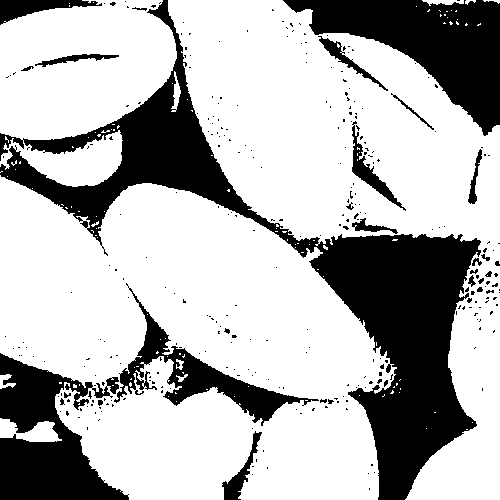

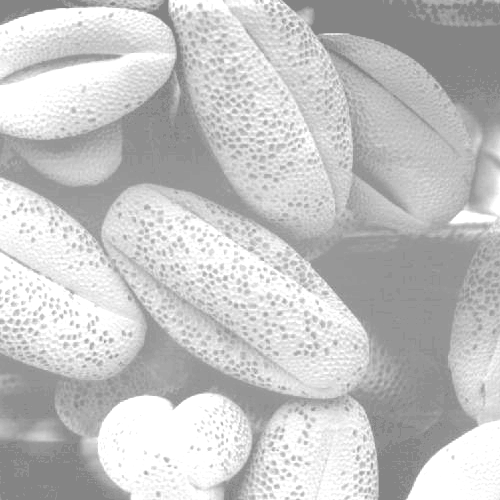

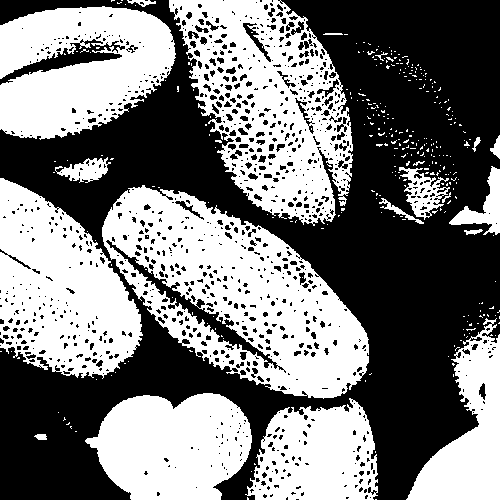

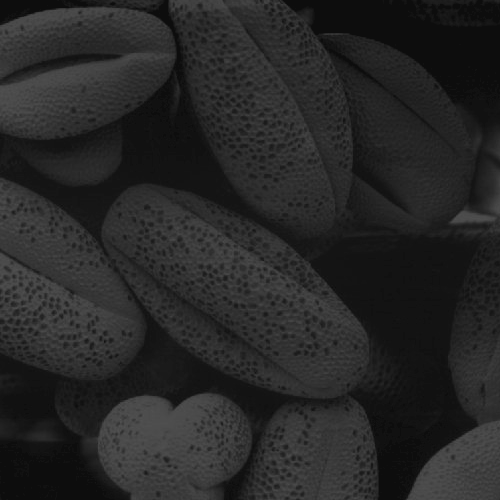

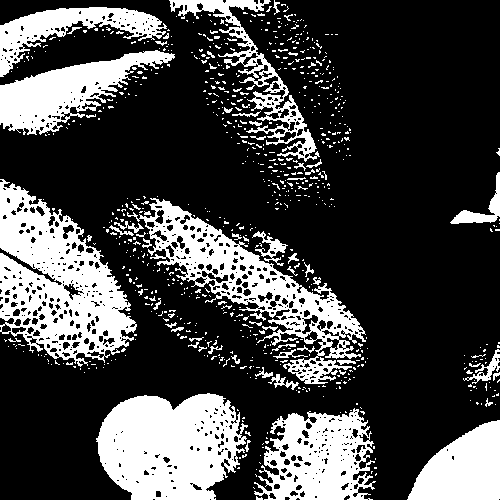

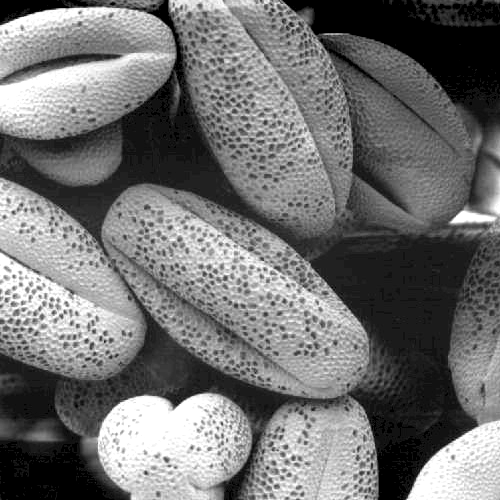

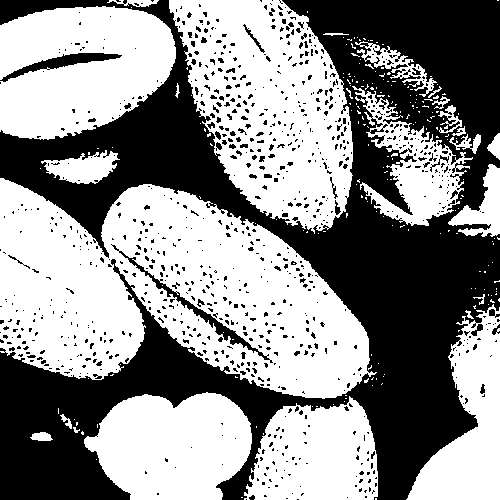

In [1]:
import cv2
from google.colab.patches import cv2_imshow

def image_thresholding(image_path, threshold_value):
  try:
    # Load the image using OpenCV
    img = cv2.imread(image_path)

    # Apply thresholding
    ret, thresholded_img = cv2.threshold(img, threshold_value, 255, cv2.THRESH_BINARY)


    # Display the original and thresholded images
    cv2_imshow(img)
    cv2_imshow(thresholded_img)

    cv2.destroyAllWindows()

  except Exception as e:
    print(f"An error occurred: {e}")


image_path = "/content/data/low_contrast.tif"
threshold_value = 100
image_thresholding(image_path, threshold_value)

image_path = "/content/data/bright.tif"
threshold_value = 200
image_thresholding(image_path, threshold_value)

image_path = "/content/data/dark.tif"
threshold_value = 50
image_thresholding(image_path, threshold_value)

image_path = "/content/data/high_contrast.tif"
threshold_value = 100
image_thresholding(image_path, threshold_value)

# **2. Image arithmetic operations**

### Lab Task 02 :
Read two images and perform addition and subtraction

Basic arithmetic operations like addition, subtraction, division, multiplication can be
performed quickly and easily on image pixels for a variety of effects and applications.
These operations are carried out between corresponding pixel pairs of two images of the
same size

In [2]:
def image_adition(path1, path2):

    # Loading images
    image1 = cv2.imread(path1)
    image2 = cv2.imread(path2)

    # Adding Images
    result_image = image1 + image2
    cv2_imshow(image1)
    cv2_imshow(image2)
    cv2_imshow(result_image)
    cv2.waitKey(0)

def image_sub(path1, path2):

    # Loading images
    image1 = cv2.imread(path1)
    image2 = cv2.imread(path2)

    # Adding Images
    result_image = image1 - image2
    cv2_imshow(image1)
    cv2_imshow(image2)
    cv2_imshow(result_image)
    cv2.waitKey(0)

def image_mult(path1, path2):

    # Loading images
    image1 = cv2.imread(path1)
    image2 = cv2.imread(path2)

    # Adding Images
    result_image = image1 * image2
    cv2_imshow(image1)
    cv2_imshow(image2)
    cv2_imshow(result_image)
    cv2.waitKey(0)

def image_div(path1, path2):

    # Loading images
    image1 = cv2.imread(path1)
    image2 = cv2.imread(path2)

    # Adding Images
    result_image = image1 / image2
    cv2_imshow(image1)
    cv2_imshow(image2)
    cv2_imshow(result_image)
    cv2.waitKey(0)


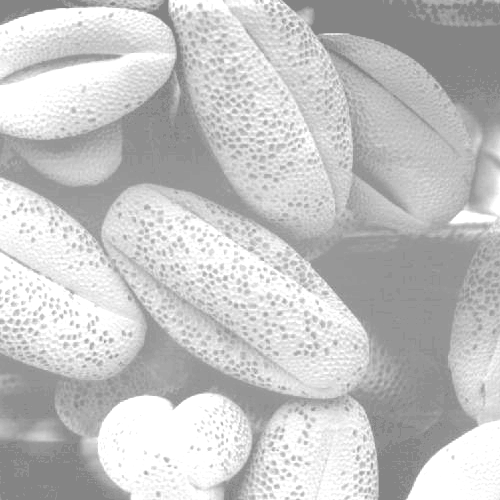

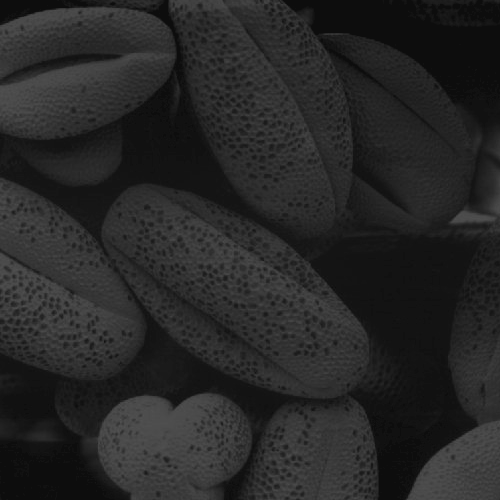

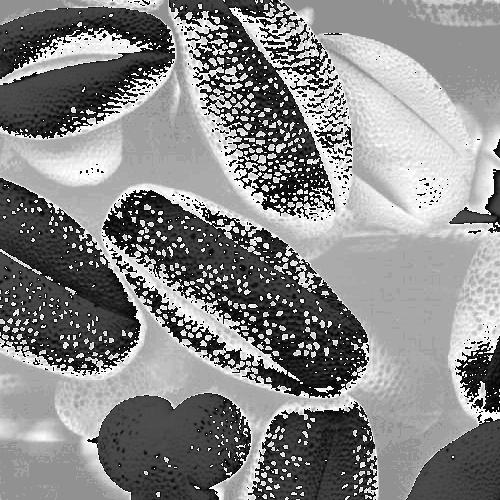

In [3]:

image1path = '/content/data/bright.tif'
image2path = '/content/data/dark.tif'

image_adition(image1path, image2path)

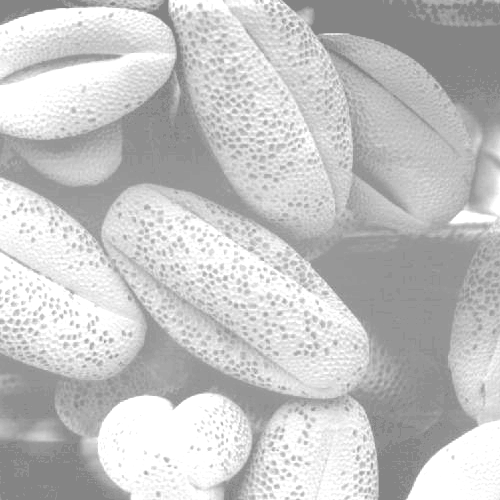

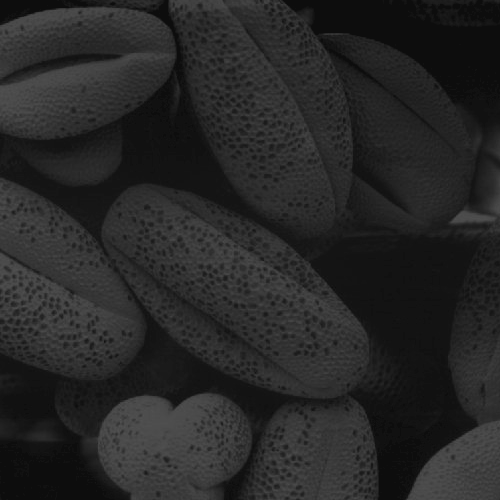

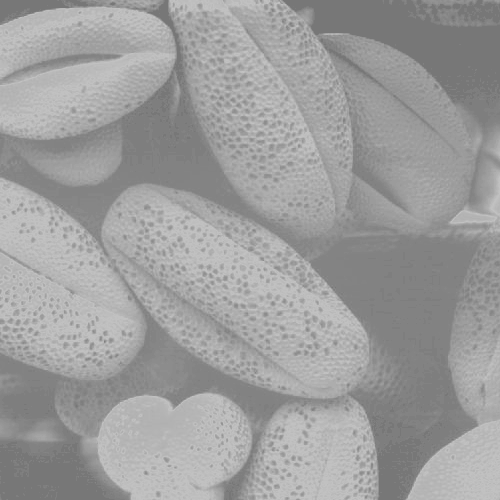

In [4]:

image1path = '/content/data/bright.tif'
image2path = '/content/data/dark.tif'

image_sub(image1path, image2path)

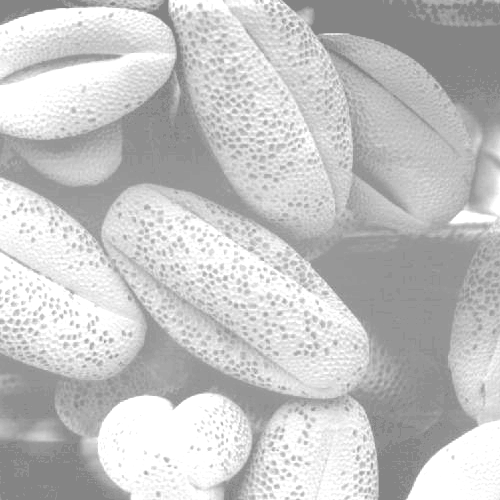

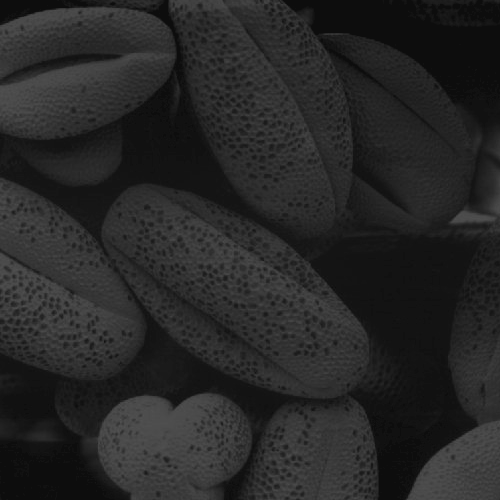

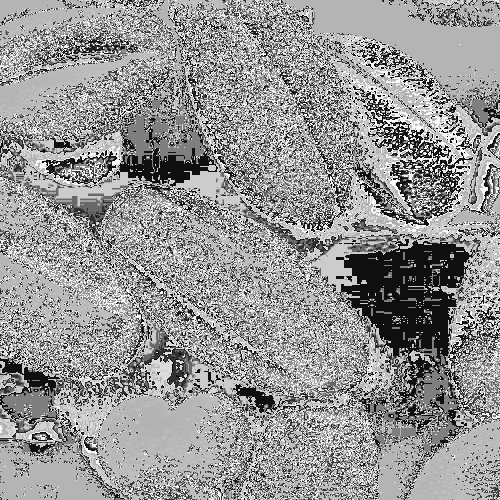

In [5]:

image1path = '/content/data/bright.tif'
image2path = '/content/data/dark.tif'

image_mult(image1path, image2path)

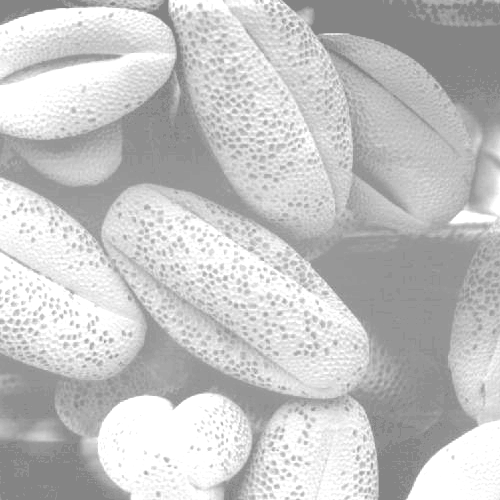

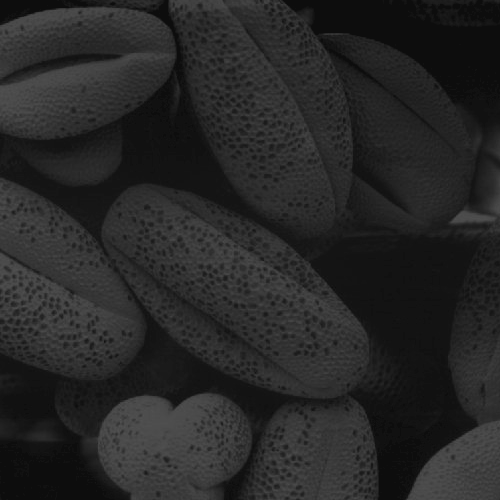

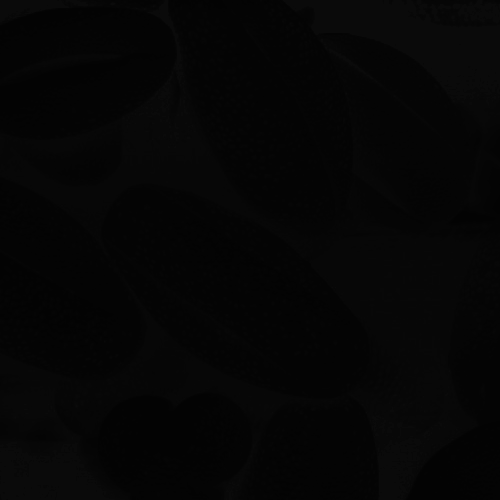

In [6]:

image1path = '/content/data/bright.tif'
image2path = '/content/data/dark.tif'

image_div(image1path, image2path)

# **3. Spatial Processing**

### Lab Task 03 :

**1.** Write simple programs to demonstrate the following. Show the original and
resultant images in the same figure to compare them easily.
1.  Log transformation

2.  Power transformation
3.  Contrast Stretching
4.  Gray level slicing
5.  Bit plane slicing

In [7]:
import numpy as np
import matplotlib.pyplot as plt


def plot_images_before_and_after(before, after, transformation_name):
    # Display original and transformed images side-by-side
    plt.subplot(121),plt.imshow(before),plt.title('Input')
    plt.subplot(122),plt.imshow(after),plt.title(transformation_name)
    plt.show()

def transformation_plot(original_values, transformed_values, transformation):
    # Plot the original and transformed values
    plt.figure(figsize=(8, 6))
    plt.plot(original_values, transformed_values, label=f'Transformation Curve({transformation})')
    plt.xlabel('Original Values (x-axis)')
    plt.ylabel('Transformed Values (y-axis)')
    plt.title('Original vs Transformed Values')
    plt.grid(True)
    plt.legend()
    plt.show()


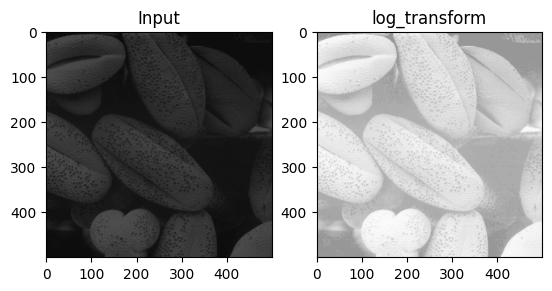

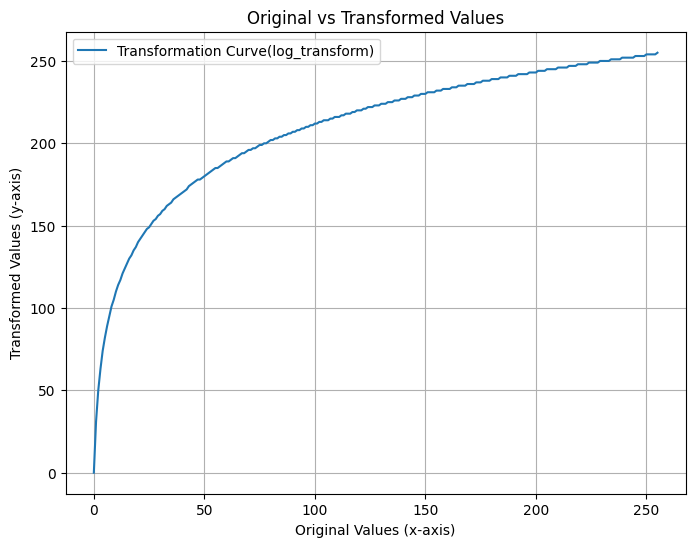

In [8]:
def log_transform(img):

    # getting Scaling Constant
    c = 255 / np.log(1 + np.max(img))

    # Getting log image
    log_image = c * np.log(1 + img)

    # Converting to Integer type(might be floating after Div)
    log_image = np.array(log_image, dtype=np.uint8)

    return log_image


image_path = "/content/data/dark.tif"
# Reading the image
img = cv2.imread(image_path)
plot_images_before_and_after(img, log_transform(img), 'log_transform')

# Generate dataset of numbers from 0 to 255
original_values = np.arange(0, 256)

# Apply the transformation function
transformed_values = log_transform(original_values)

# Ensure transformed values are within a displayable range if needed
transformed_values = np.clip(transformed_values, 0, 255)

transformation_plot(original_values, transformed_values, 'log_transform')


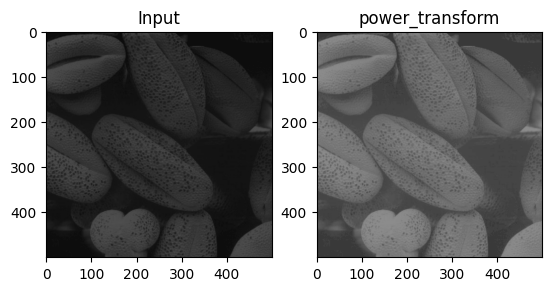

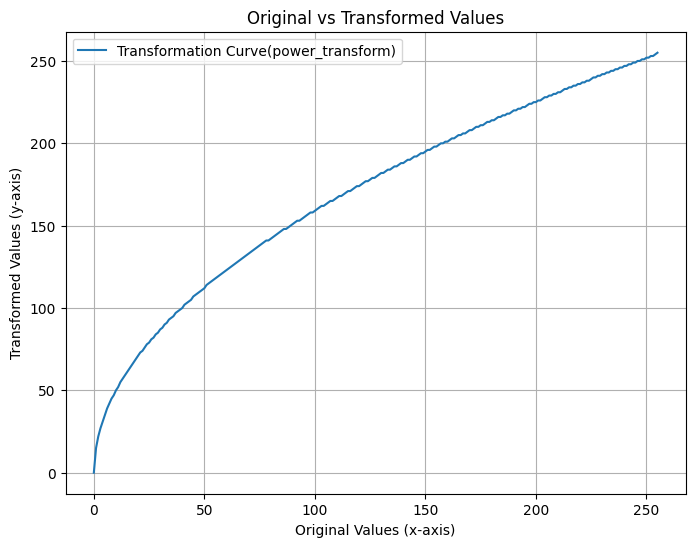

In [9]:
def power_transform(img, gamma):
    power_image = np.array(255*(img / 255) ** gamma, dtype='uint8')

    return power_image


image_path = "/content/data/dark.tif"
# Reading the image
img = cv2.imread(image_path)
plot_images_before_and_after(img, power_transform(img, 0.5), 'power_transform')

# Generate dataset of numbers from 0 to 255
original_values = np.arange(0, 256)

# Apply the transformation function
transformed_values = power_transform(original_values, 0.5)

# Ensure transformed values are within a displayable range if needed
transformed_values = np.clip(transformed_values, 0, 255)

transformation_plot(original_values, transformed_values, 'power_transform')

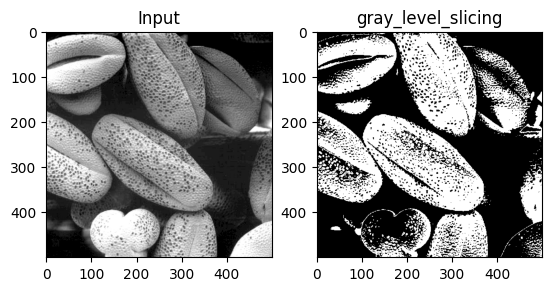

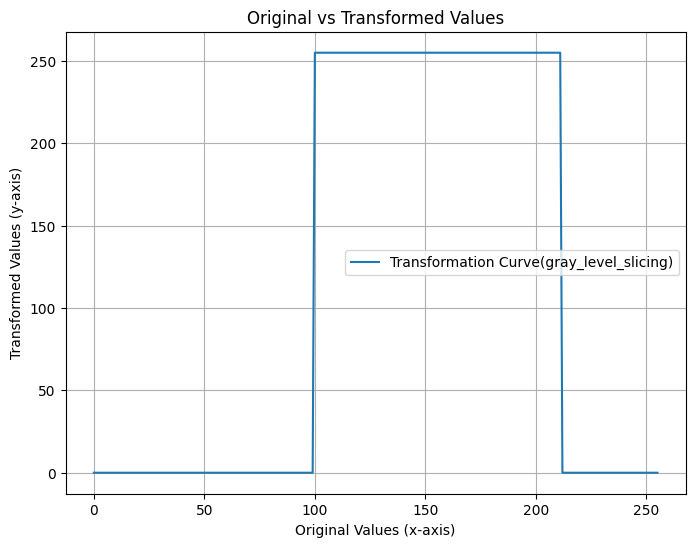

In [10]:
def gray_level_slicing(img, level_min, level_max):
    sliced_values = np.zeros_like(img)
    sliced_values[(img >= level_min) & (img <= level_max)] = 255
    return sliced_values

image_path = "/content/data/high_contrast.tif"
# Reading the image
img = cv2.imread(image_path)
sliced = gray_level_slicing(img.copy(), 100, 211)
plot_images_before_and_after(img, sliced, 'gray_level_slicing')

# Generate dataset of numbers from 0 to 255
original_values = np.arange(0, 256)

# Apply the transformation function
transformed_values = gray_level_slicing(original_values, 100, 211)

# Ensure transformed values are within a displayable range if needed
transformed_values = np.clip(transformed_values, 0, 255)

transformation_plot(original_values, transformed_values, 'gray_level_slicing')

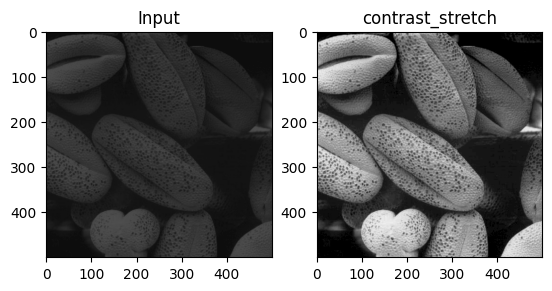

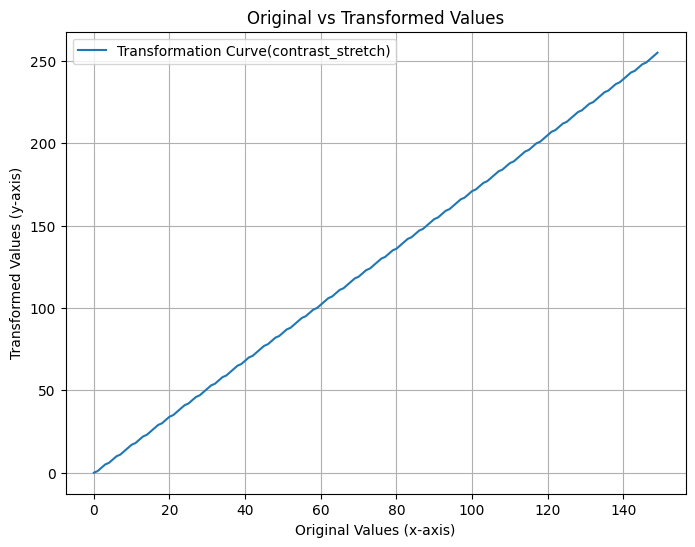

In [11]:
def contrast_stretch(img):
    min_val = np.min(img)
    max_val = np.max(img)
    stretched_image = (img - min_val) * (255 / (max_val - min_val))
    return np.array(stretched_image, dtype=np.uint8)


image_path = "/content/data/dark.tif"
# Reading the image
img = cv2.imread(image_path)
plot_images_before_and_after(img, contrast_stretch(img), 'contrast_stretch')

# Generate dataset of numbers from 0 to 150
original_values = np.arange(0, 150)

# Apply the transformation function
transformed_values = contrast_stretch(original_values)

# Ensure transformed values are within a displayable range if needed
transformed_values = np.clip(transformed_values, 0, 255)

transformation_plot(original_values, transformed_values, 'contrast_stretch')

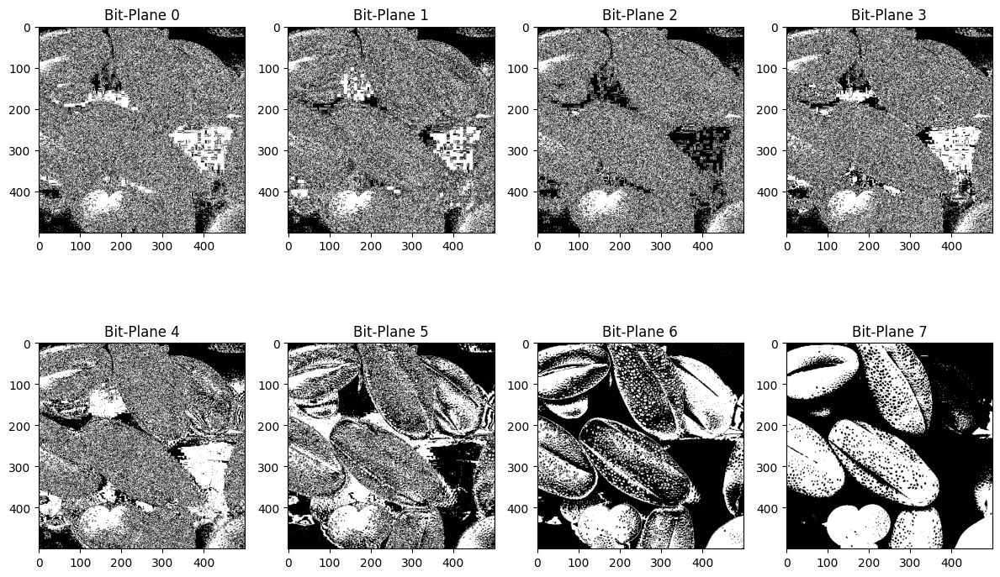

In [12]:
def extract_bit_plane(image, bit_index):
    return (image >> bit_index) & 1

# Read the grayscale image from the specified file path.
image_path = '/content/data/high_contrast.tif'
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Plot all 8 bit planes
plt.figure(figsize=(12, 8))

for i in range(8):
    # Use the function to extract the bit plane
    bit_plane = extract_bit_plane(image, i)
    # Add a subplot to the figure
    plt.subplot(2, 4, i + 1)
    # Display the bit plane as a grayscale image
    plt.imshow(bit_plane, cmap='gray')
    # Set the title for the subplot
    plt.title(f'Bit-Plane {i}')

# show all the subplots together
plt.tight_layout()
plt.show()

2. Consider the graph for a typical transformation function used for Contrast
Stretching in the given figure and determine the behavior of the function with
respect to given changes.


a. When r1 =s1 and r2=s2

then the points are in the line of r = s.

So the constructed final transition will be same as r = s.

threfore the output is same as input

b. When r1=r2, s1=0 and s2=L-1

Here, the inputs from the intensity 0 to value of r1 (=r2) are outputted as intensity 0 (black) and values from the intensity value of r1 (=r2) to 255 are outputted as 255 (white).

So this works as a thresholding and the thresholding value is the value of r1 (=r2).

# 4. **Masking**

### Lab Task 04 :

Write a program to read any image, resize it to 256x256. Apply the
masks shown in following figures so that only the middle part of the image is
visible.

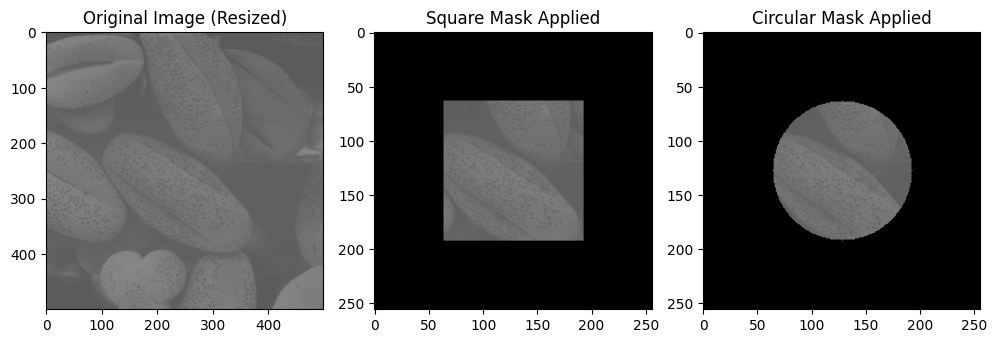

In [13]:
def apply_masks(image_path):
    # Load the image
    image = cv2.imread(image_path)

    #Resize the image to 256x256
    resized_image = cv2.resize(image, (256, 256))

    # generate a square mask
    square_mask = np.zeros((256, 256), dtype=np.uint8)
    cv2.rectangle(square_mask, (64, 64), (192, 192), 255, -1)

    # generate a circular mask
    circular_mask = np.zeros((256, 256), dtype=np.uint8)
    cv2.circle(circular_mask, (128, 128), 64, 255, -1)

    # aplly the square mask
    square_masked_image = cv2.bitwise_and(resized_image, resized_image, mask=square_mask)

    # apply the circular mask
    circular_masked_image = cv2.bitwise_and(resized_image, resized_image, mask=circular_mask)

    return square_masked_image, circular_masked_image

#  Path to the input image
image_path = "/content/data/low_contrast.tif"

# apply the masks
square_result, circular_result = apply_masks(image_path)

# showw results
plt.figure(figsize=(10, 5))

plt.subplot(1, 3, 1)
plt.title("Original Image (Resized)")
plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))

plt.subplot(1, 3, 2)
plt.title("Square Mask Applied")
plt.imshow(cv2.cvtColor(square_result, cv2.COLOR_BGR2RGB))

plt.subplot(1, 3, 3)
plt.title("Circular Mask Applied")
plt.imshow(cv2.cvtColor(circular_result, cv2.COLOR_BGR2RGB))

plt.tight_layout()
plt.show()


# **5. Brightness**

### Lab Task 05 :

Write your own Python OpenCV function addbrightness() and use
it to increase brightness of a given image.(Hint: Use Image arithmetic operations)

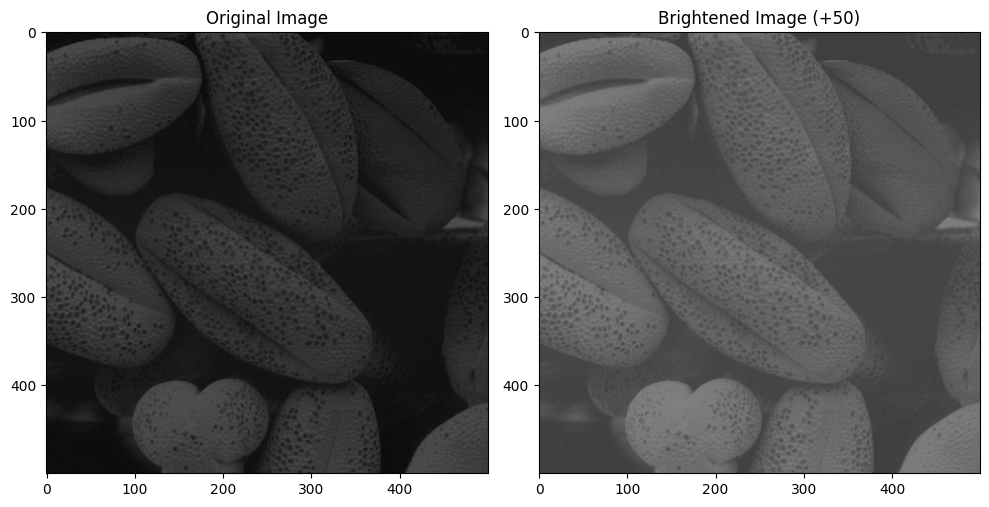

In [14]:
def addbrightness(image, value):
    # Ensure the value is within a valid range
    value = np.clip(value, 0, 255)

    # Add the value to the image pixel intensities
    brightened_image =  image + value

    return brightened_image

# Load the input image
image_path = "/content/data/dark.tif"
image = cv2.imread(image_path)

# Apply the addbrightness function with a brightness value of 50
brightness_value = 50
brightened_image = addbrightness(image, brightness_value)

# show the original and brightened images
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

plt.subplot(1, 2, 2)
plt.title(f"Brightened Image (+{brightness_value})")
plt.imshow(cv2.cvtColor(brightened_image, cv2.COLOR_BGR2RGB))

plt.tight_layout()
plt.show()

# **6. Histogram Processing**

### Lab Task 06 :

1. Histogram Calculation in OpenCV
Use inbuilt OpenCV cv2.calcHist() function to display the histogram of a given
image.

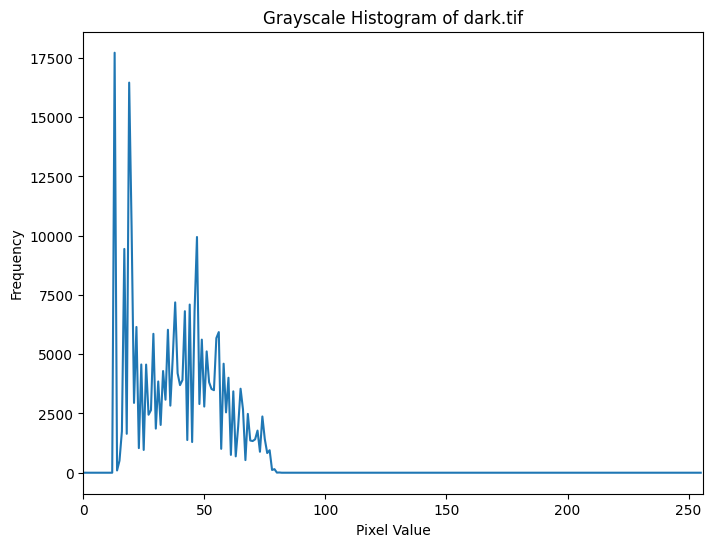

In [15]:
def show_histogram(image_path, image_name):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # load as grayscale

    # cal histogram
    hist = cv2.calcHist([img], [0], None, [256], [0, 256])

    # plot histogram
    plt.figure(figsize=(8, 6))
    plt.title(f"Grayscale Histogram of {image_name}")
    plt.xlabel("Pixel Value")
    plt.ylabel("Frequency")
    plt.xlim([0, 256])
    plt.plot(hist)
    plt.show()

# to read Non-grayscale hisogram
# def show_histogram(image_path):
#     img = cv2.imread(image_path)
#     assert img is not None, "file could not be read, check with os.path.exists()"
#     color = ('b','g','r')
#     for i,col in enumerate(color):
#         histr = cv.calcHist([img],[i],None,[256],[0,256])
#         plt.plot(histr,color = col)
#         plt.xlim([0,256])
#     plt.show()

image_path = "/content/data/dark.tif"
show_histogram(image_path, 'dark.tif')


3. Then write your own histogram functions for the following scenarios

a. Show a histogram plot for a grayscale image.

b. Show three histograms for a given RGB image.

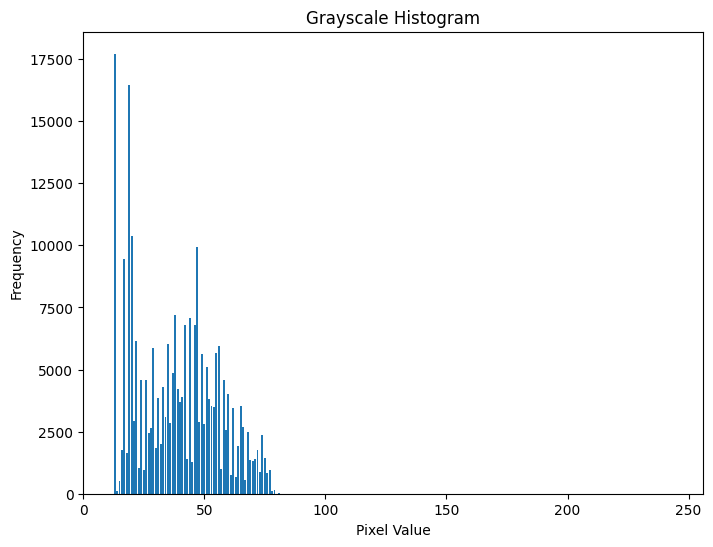

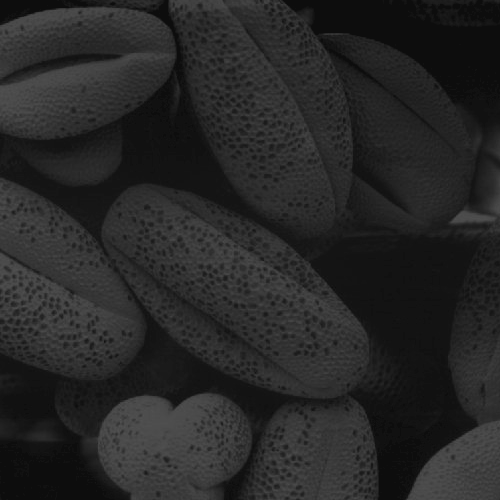

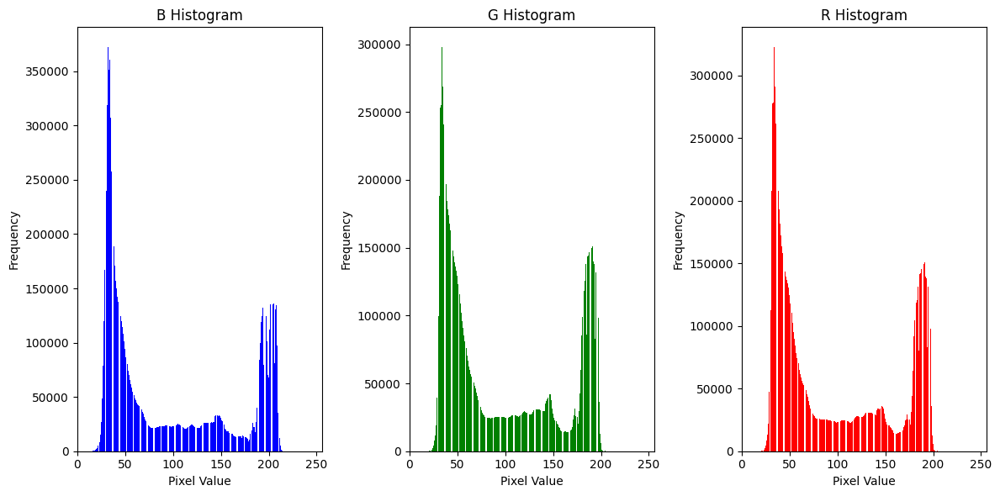

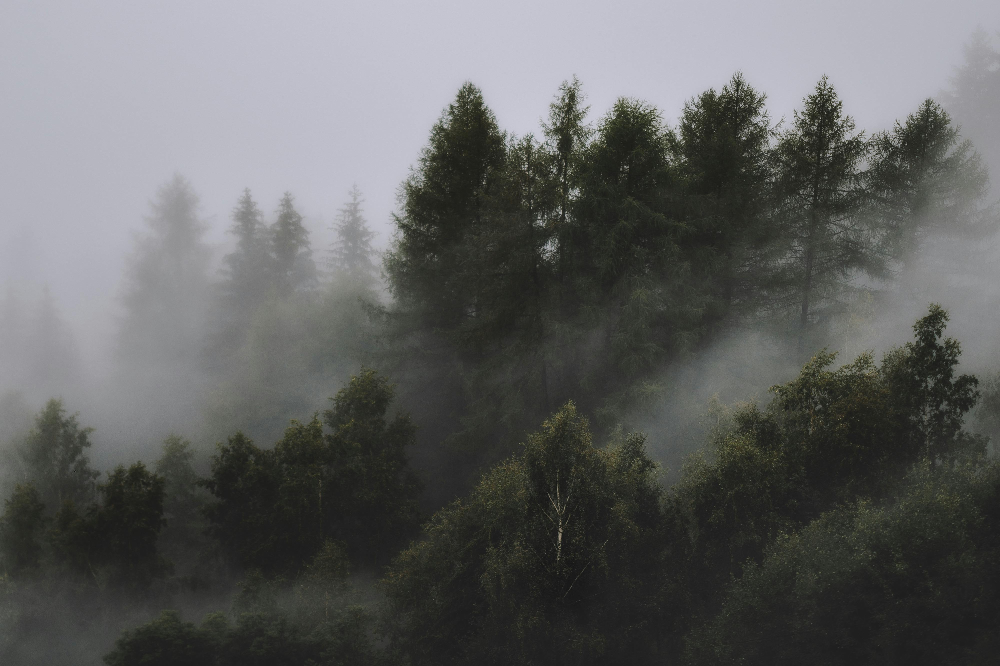

In [16]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def my_grayscale_histogram(image_path):
    #check if image available
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"Error: Could not read image at {image_path}")
        return
    # array to keep the count of each intensity pixels
    hist = np.zeros(256, dtype=int) # discrete values
    for row in img:
        for pixel in row:
            hist[pixel] += 1

    # Plot histogram
    plt.figure(figsize=(8, 6))
    plt.title("Grayscale Histogram")
    plt.xlabel("Pixel Value")
    plt.ylabel("Frequency")
    plt.xlim([0, 256])
    plt.bar(range(256), hist)
    plt.show()


def my_rgb_histogram(image_path):
    img = cv2.imread(image_path)
    #check if image available
    if img is None:
        print(f"Error: Could not read image at {image_path}")
        return
    colors = ('b', 'g', 'r')
    plt.figure(figsize=(12, 6))
    for i, color in enumerate(colors):
      hist = np.zeros(256, dtype=int)
      for row in img:
        for pixel in row:
            hist[pixel[i]] += 1 # Since each have R G B value, extract each

      # Plot histogram
      plt.subplot(1, 3, i+1)
      plt.title(f"{color.upper()} Histogram")
      plt.xlabel("Pixel Value")
      plt.ylabel("Frequency")
      plt.xlim([0, 256])
      plt.bar(range(256), hist, color=color)
    plt.tight_layout()
    plt.show()

my_grayscale_histogram('/content/data/dark.tif')
cv2_imshow(cv2.imread('/content/data/dark.tif'))

my_rgb_histogram('/content/data/pexels-eberhardgross-1367192.jpg')
cv2_imshow(cv2.imread('/content/data/pexels-eberhardgross-1367192.jpg'))

4. Consider the four images given in the resources folder. Plot the histogram for each
image. Perform Histogram Equalization on each image and plot the histograms of
the resultant images. Comment on the results you have obtained.

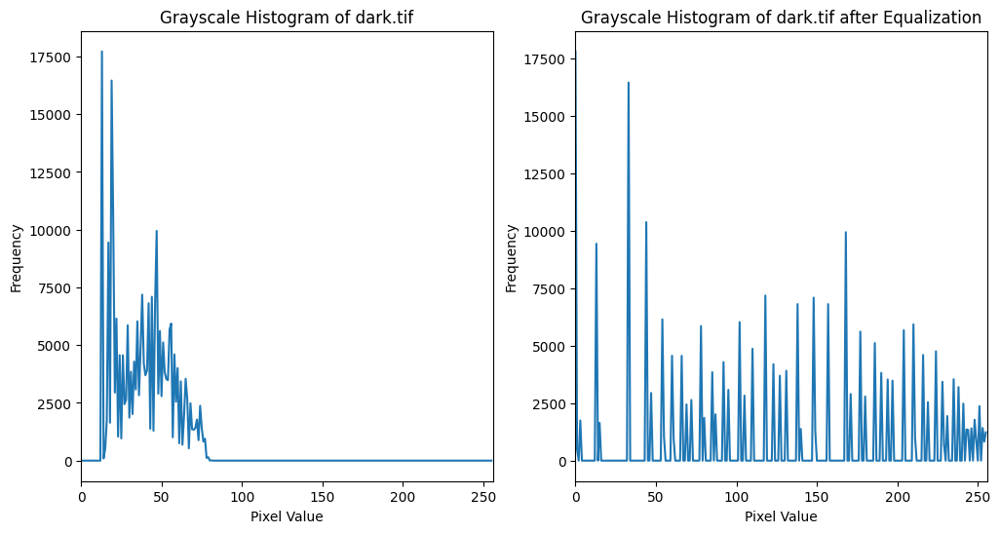

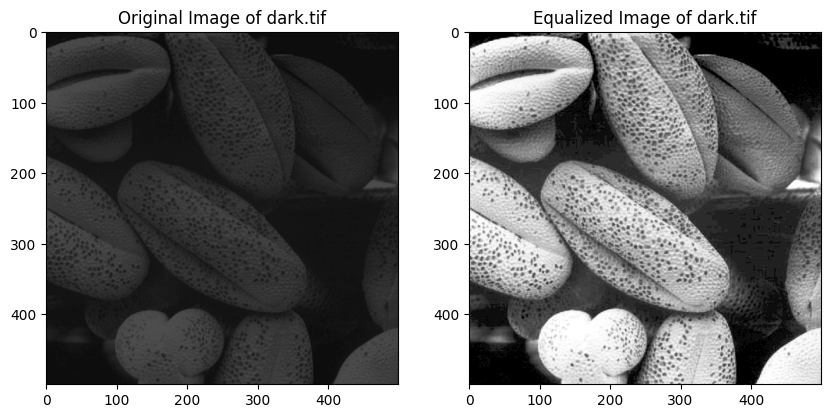

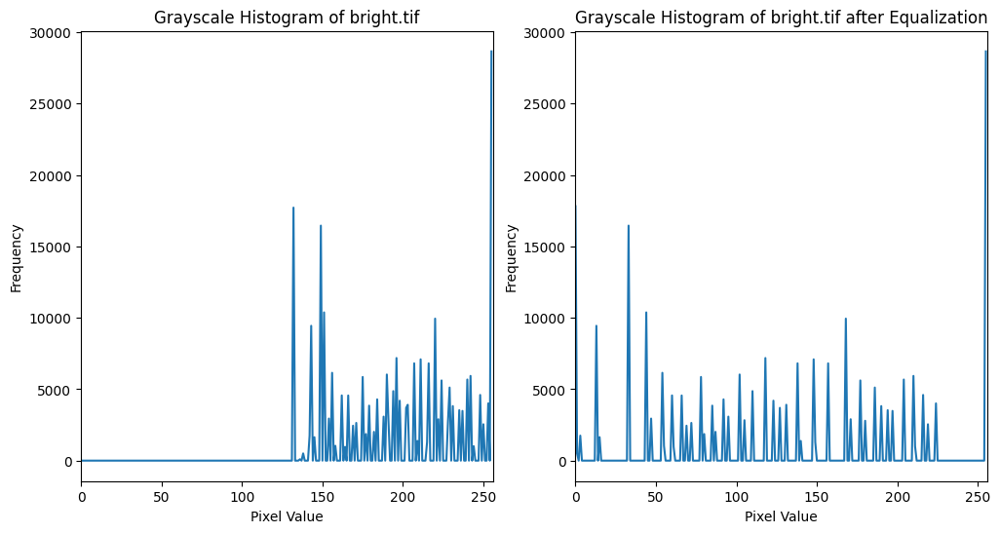

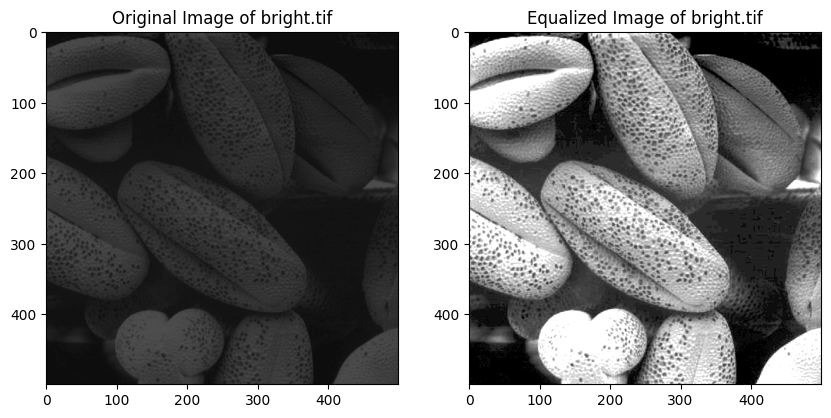

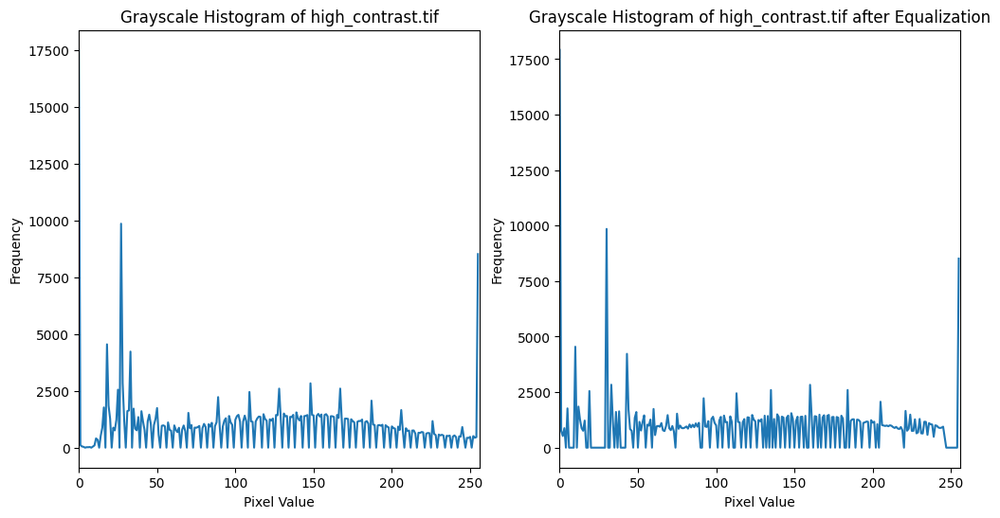

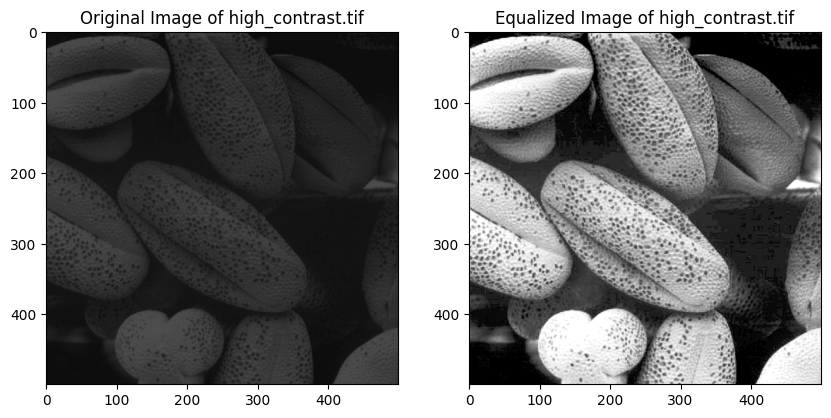

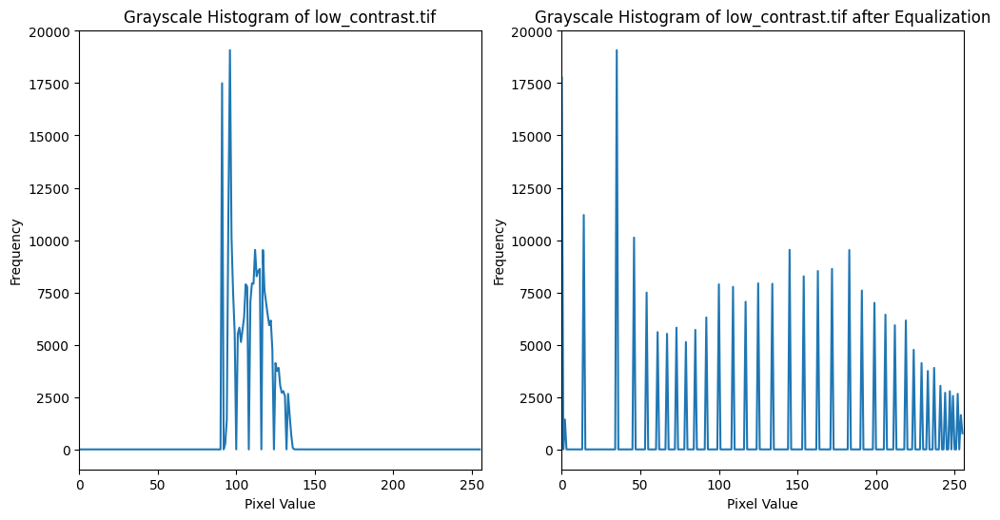

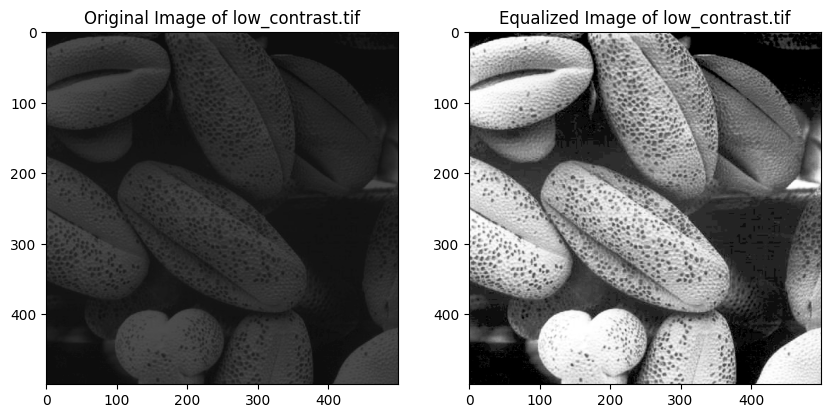

In [29]:
def show_histogram_equalization(image_path, image_name):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    # Calculate histogram
    hist = cv2.calcHist([img], [0], None, [256], [0, 256])

    # Perform histogram equalization
    equ = cv2.equalizeHist(img)
    hist_equ = cv2.calcHist([equ], [0], None, [256], [0, 256])

    # Plot histograms
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title(f"Grayscale Histogram of {image_name}")
    plt.xlabel("Pixel Value")
    plt.ylabel("Frequency")
    plt.xlim([0, 256])
    plt.plot(hist)

    plt.subplot(1, 2, 2)
    plt.title(f"Grayscale Histogram of {image_name} after Equalization")
    plt.xlabel("Pixel Value")
    plt.ylabel("Frequency")
    plt.xlim([0, 256])
    plt.plot(hist_equ)

    plt.show()

    # Display original and equalized images
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title(f"Original Image of {image_name}")
    plt.imshow(image)

    plt.subplot(1, 2, 2)
    plt.title(f"Equalized Image of {image_name}")
    plt.imshow(equ, cmap='gray')
    plt.show()

show_histogram_equalization("/content/data/dark.tif", 'dark.tif')
show_histogram_equalization("/content/data/bright.tif", 'bright.tif')
show_histogram_equalization("/content/data/high_contrast.tif", 'high_contrast.tif')
show_histogram_equalization("/content/data/low_contrast.tif", 'low_contrast.tif')

the dark image seems to have low intensity pixels. making the overall image darker

the bright image seems to have high intensity values pixes more. making the overall image bright

high contrast image seems to have overall spread of pixes=ls between  highest and lowest intensity valued pixels, making a high contrast image.

the low contrast image seems to have mid level intensity pixels only, making the image low contrast.

In [21]:
!jupyter nbconvert --to html /content/ImageProcessing_Lab02.ipynb

[NbConvertApp] WARNING | pattern '/content/ImageProcessing_Lab02.ipynb' matched no files
This application is used to convert notebook files (*.ipynb)
        to various other formats.


Options
The options below are convenience aliases to configurable class-options,
as listed in the "Equivalent to" description-line of the aliases.
To see all configurable class-options for some <cmd>, use:
    <cmd> --help-all

--debug
    set log level to logging.DEBUG (maximize logging output)
    Equivalent to: [--Application.log_level=10]
--show-config
    Show the application's configuration (human-readable format)
    Equivalent to: [--Application.show_config=True]
--show-config-json
    Show the application's configuration (json format)
    Equivalent to: [--Application.show_config_json=True]
--generate-config
    generate default config file
    Equivalent to: [--JupyterApp.generate_config=True]
-y
    Answer yes to any questions instead of prompting.
    Equivalent to: [--JupyterApp.answer_yes=